<a href="https://colab.research.google.com/github/mayankjain281/Supervised_Machine_Learning/blob/main/LinearRegression3_RevisionNotes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Content
- Assumption of Linear Regression
  - Assumption of Linearity
  - Features are not multi-Collinear
   - Collinearity 
   - Multi-Collinearity 
   - VIF

  - Errors are normally Distributed
  - Heteroskedasticity should not exist
  - No Autocorrelation
- Training,Validation, Test data

# Assumptions of Linear Regression

- We can arrive at concept of Linear regression in two ways
  - Algebra & Optimization (Geometric) - We covered this
  - Probability & Stats
- We can prove that Linear regression is a very good model if all the statistical assumptions holds true.


## **1.Assumption of Linearity**



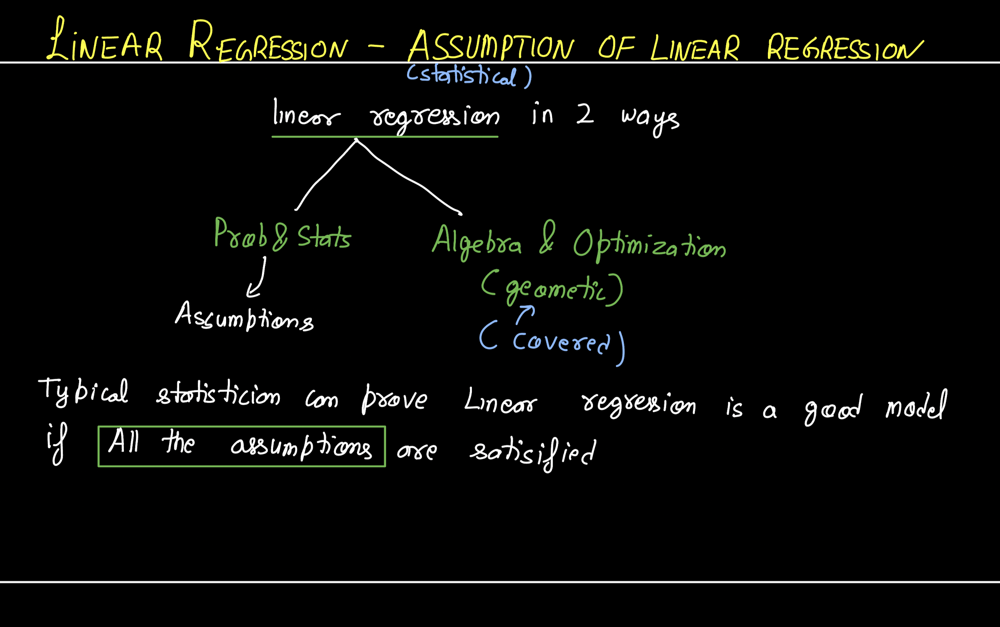

- There exists a linear function of d-dim s.t `y_i = f_linear(xi)`. 
- There is a linear relationship or linear function such that if we give a point xi to it, it can predict yi.


## **2. Features are not multi-collinear**



**Collinearity**

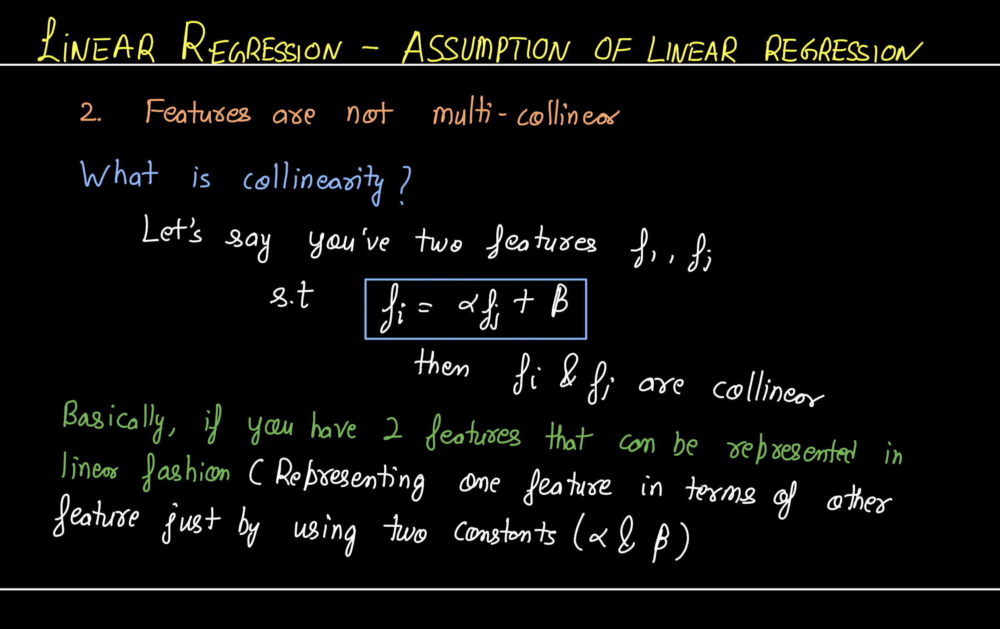

- Assume you've two features fi and fj such that fi can be represented as `a *fj + b`, then fi and fj are said to be collinear
- If you have two features which can be represented in linear fashion i.e representing one feature in terms of other feature just by using two constants (a and b)

**Multi-Collinearity**

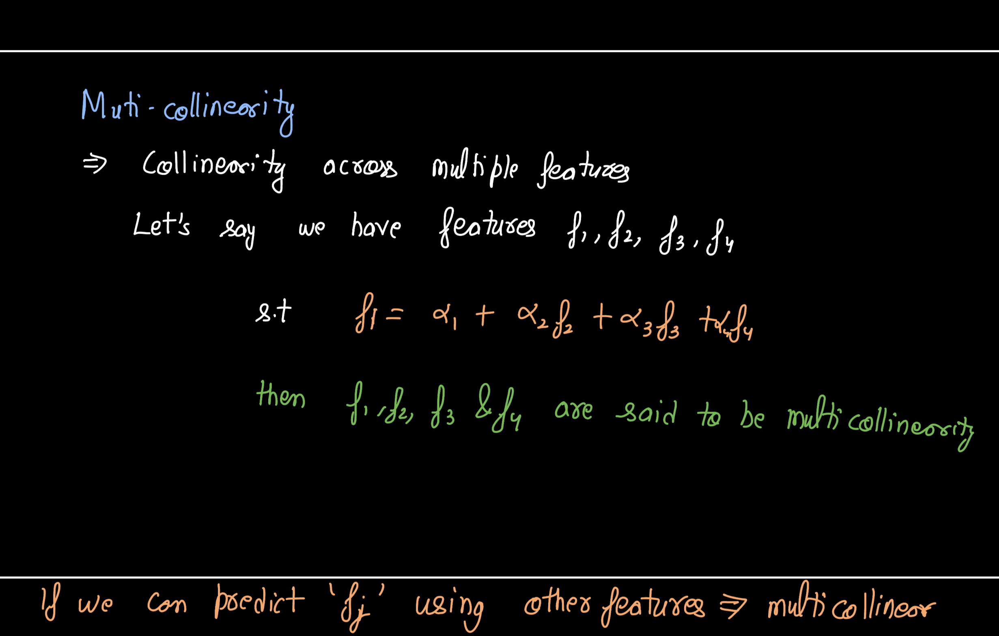

- Multicollinearity is defined as collinearity across multiple features
- If you have 4 features f1, f2, f3 and f4 and f1 can be represented using `a + b*f1 + c*f2 + d*f3`, then features are said to be multicollinear


### **Why is multi-collinearity a problem?**

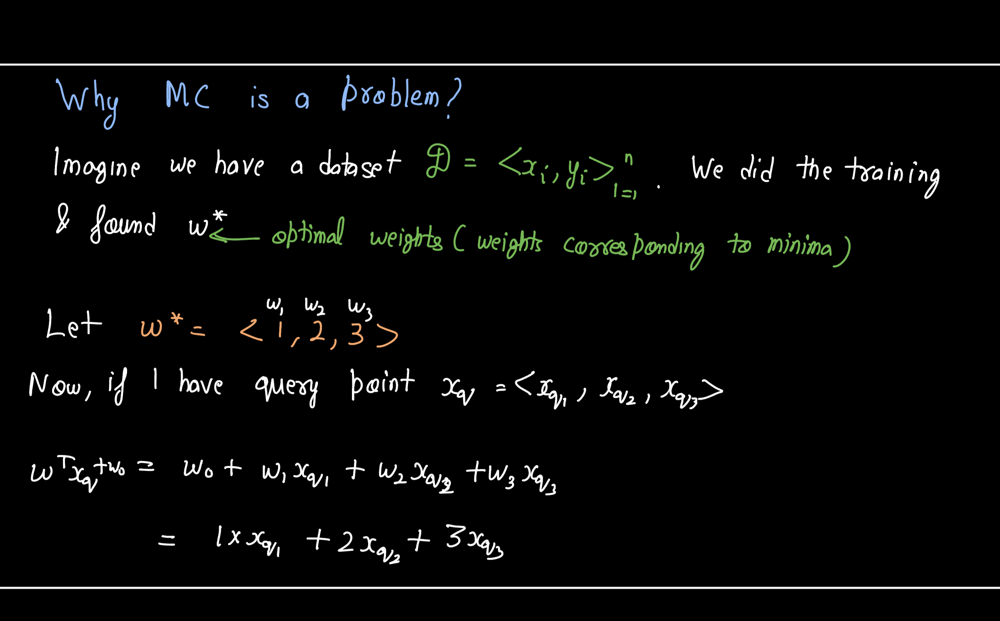

- Imagine you had a dataset which you trained you linear regression on.
- After training you got your optimal weights w*
- Let's say you have a query point xq during test time.
- Now, `y_hat= wT*xq + w0 = w0 + w1*xq1 + w2*xq2 + w3*xq3`
- y_hat = xq1 + 2*xq2 + 3*xq3 (as w* = <1,2,3>)  


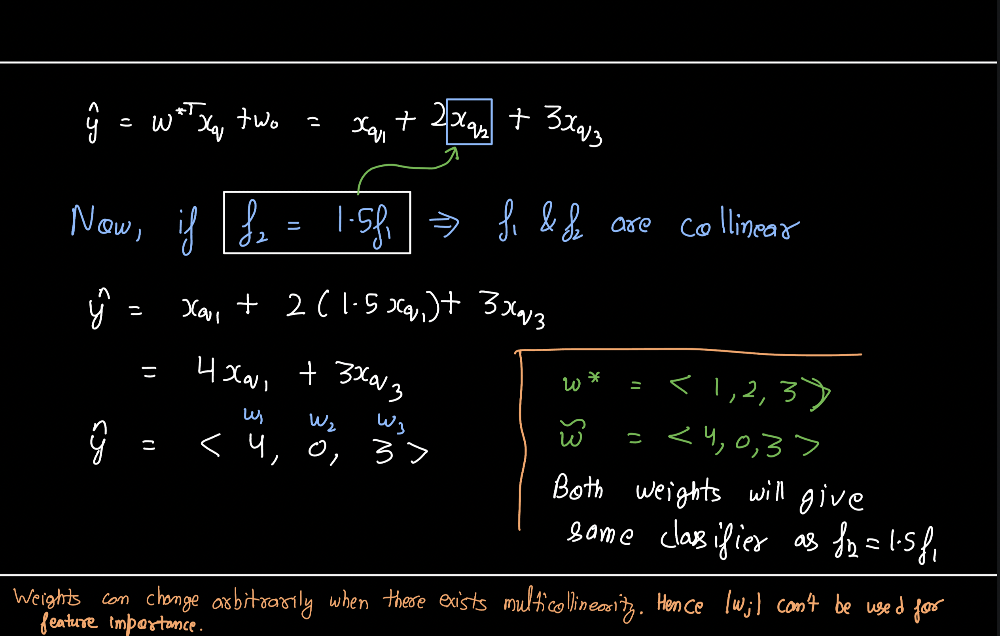

- Now, if f2 = 1.5*f1 i.e. f1 and f2 are collinear.
- Then, `y_hat = xq1 + 2(1.5*xq1) + 3*xq3 => 4*xq1 + 3*xq3`
- Weight vector becomes <4,0,3> i.e. both original and new weights will give the same classifier
- In multicollinearity, weight vector can change arbitrarily. Hence, absolute value of weight vector can't be used for feature importance. 

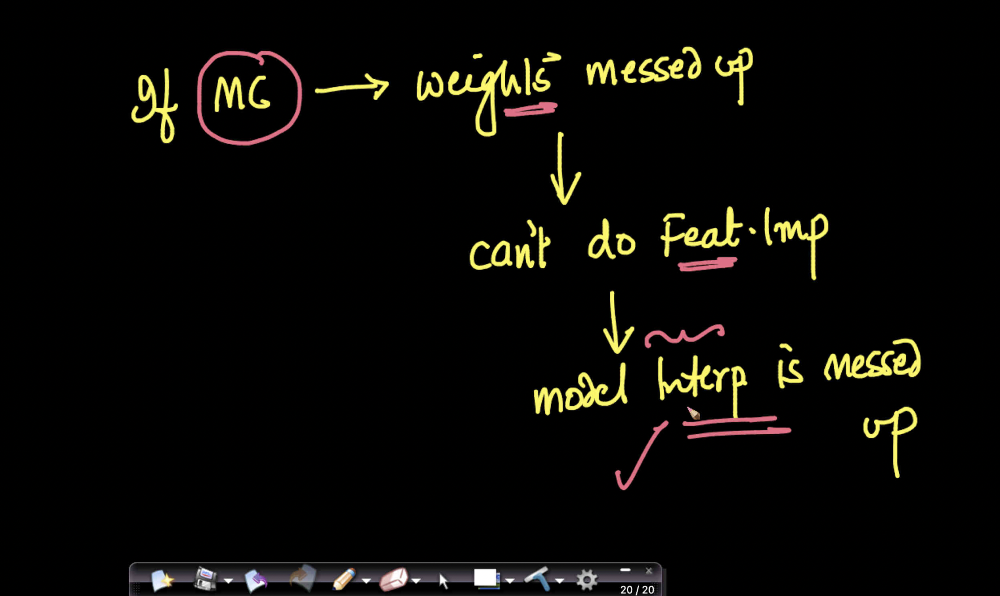

#### Question: Suppose we have two features f1 and f2 s.t f1 = log(f2). IS there a multi-collinearity in f1 and f2?
Ans: No. f1 and f2 are correlation but not multi-collinear as there is supposed to be linear function. log(x) is not linear function.

- Now that we understand Multi-Colinearity and its issues

#### How can we remove these highly correlated features?


## **VIF (Variance Inflation Factor)**

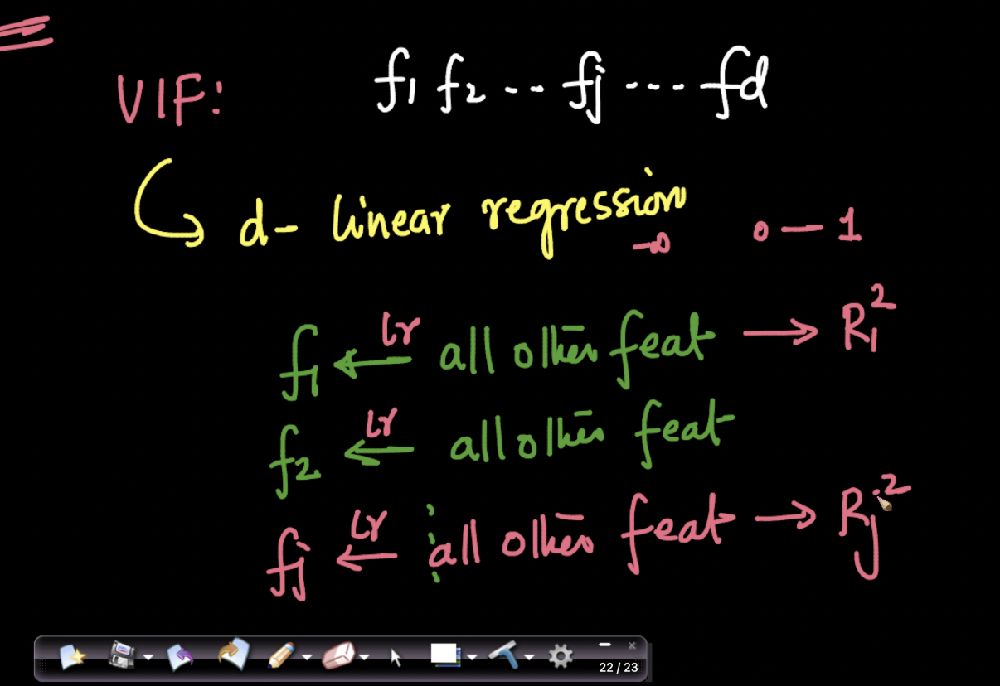

- If we had d features $(f_1,f_2,f_3....f_d)$
- we perform d-linear regression
- d means: d times linear regression model is performed

- So for a $j^{th}$ linear regresssion, we consider feature $f_j$ as our y 
- And remaining d-1 features as our X
- We train our Linear Regression model
- and predict the $R_j^2$ metric

Lets take an example for better understanding

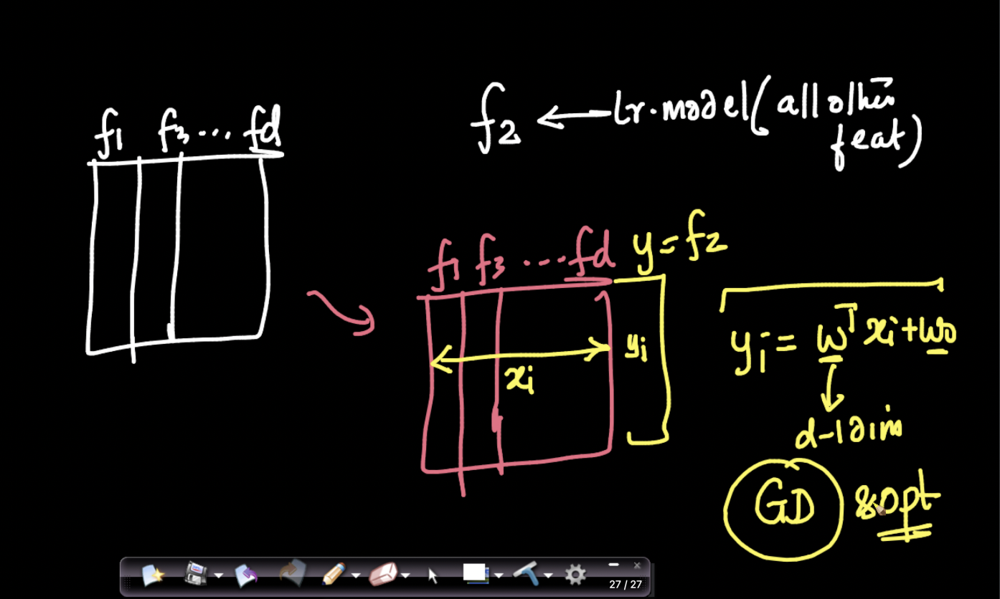

Supposedly we want to perform VIF for feature $f_2$ 
- We consider $f_2$ as our y
- the remaining d-1 features $(f_1,f_3,....,f_d)$ becomes our X
- We train a Linear Regression model for predicting $f_2$
  - $f2 = W^TX+W_0$
  - Perform Gradient Descent and Optimization
- Calculate $R^2$ Metric

#### What purpose does $R^2$ serves?
- Recall how $R^2$ measures how good our model performs and how a model is considered a best fit if $R^2$ is close to 1, 
- so if we have $R^2$ value close to one, it means the feature $f2$ is collinear with the remaining features
- Hence $f_2$ can be removed.  

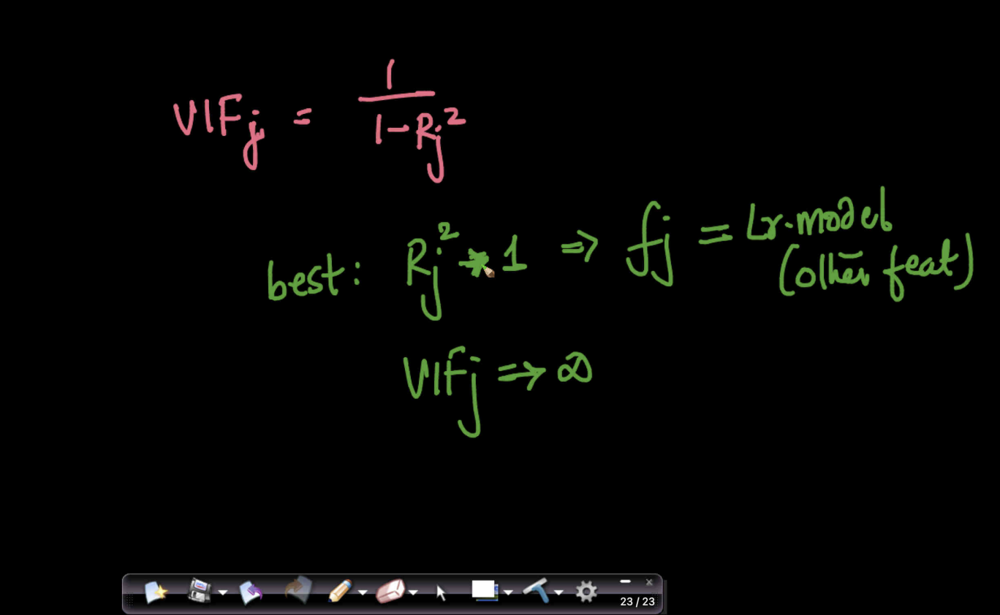

- We define VIF metric which is defined for feature $f_j$ as:
  - ${VIF}_j = \frac{1}{1-R_j^2}$ 
- For Best Linear Regression model, $R_j^2 = 1$,
- then ${VIF}_j = ∞$
- this means $f_j$ is highly multi-correlated with the remaining features and can be removed.
 

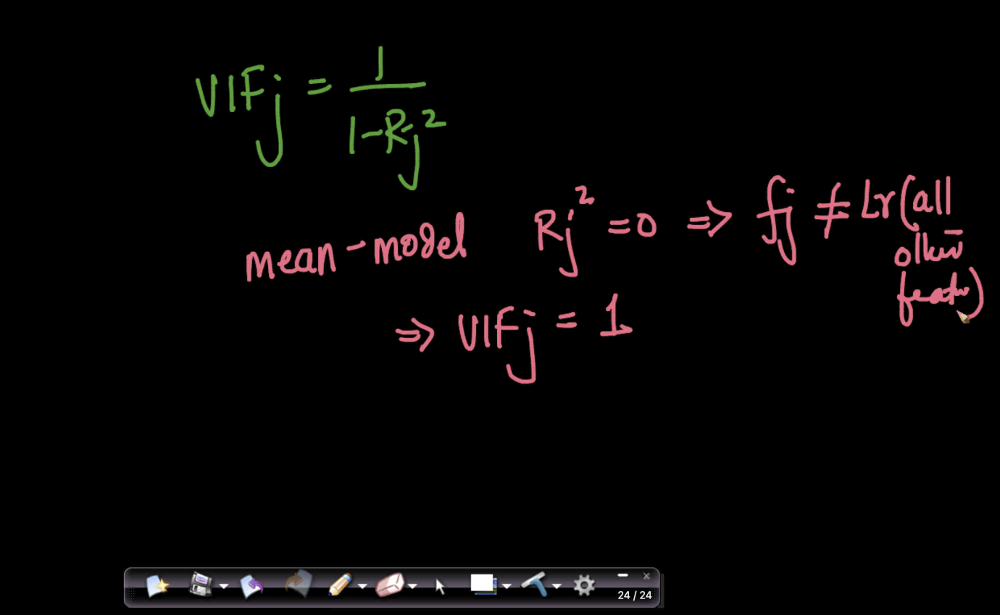

#### what if $R_j^2 = 0 $ ?
- recall how $R^2 = 0$ means only when Linear Regression model performed the same as the mean-model.
- This suggests feature $f_j$ has no multi collinearity with the other remianing d-1 features
- Here $VIF_j = 1$ 


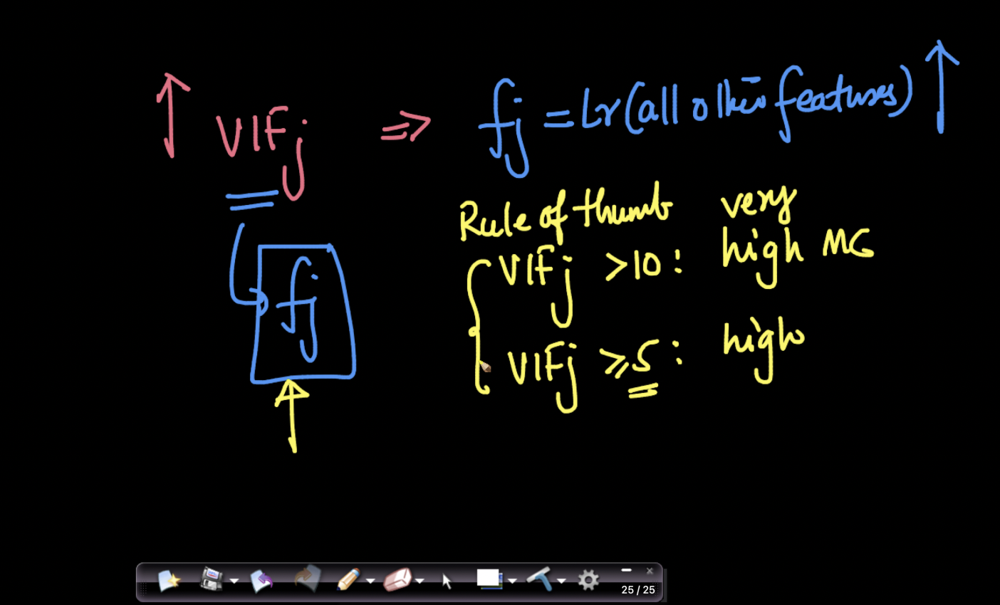

- It can be infered that if ${VIF}⇑$, that feature is more collinear
- Rule of thumb:
  - if $VIF_j > 10$ : Very High multiCollinearity
  - if 5 <= $VIF_j <10 $: High multiCollinearity 

Now lets see if there are any multi-collinear features in Cars24 data

we will be using Statsmodel for Linear Regression 

For standardization of X we will be using Scikit Learn [StandardScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)
- Which does the implementation of Standardizing features for us

In [ ]:
# Statmodels implementation of Linear regression 
import statsmodels.api as sm
# Lets scale the data, standardization 
from sklearn.preprocessing import StandardScaler

X = df[df.columns.drop('selling_price')]
Y = df["selling_price"] 

sc = StandardScaler()
cols = X.columns
X[cols] = sc.fit_transform(X[cols])

X_sm = sm.add_constant(X)  #Statmodels default is without intercept, to add intercept we need to add constant 

sm_model = sm.OLS(Y, X_sm).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:          selling_price   R-squared:                       0.942
Model:                            OLS   Adj. R-squared:                  0.942
Method:                 Least Squares   F-statistic:                 1.902e+04
Date:                Mon, 13 Jun 2022   Prob (F-statistic):               0.00
Time:                        12:54:59   Log-Likelihood:                 28825.
No. Observations:               19820   AIC:                        -5.761e+04
Df Residuals:                   19802   BIC:                        -5.747e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const                0.3051      0.000  

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/tsatools.py:117: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


####Multicollinearity
- When one or more input variables exhibhit strong correlation
- One variable is enough to be part of the model.

In [ ]:
# VIF 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [ ]:
vif = pd.DataFrame()
X_t = X
vif['Features'] = X_t.columns
vif['VIF'] = [variance_inflation_factor(X_t.values, i) for i in range(X_t.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

/usr/local/lib/python3.7/dist-packages/statsmodels/stats/outliers_influence.py:185: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


,Features,VIF
0,year,inf
5,age,inf
13,Petrol,17.95
10,Diesel,17.03
16,>5,13.32
15,5,12.08
3,engine,6.27
7,model,5.81
4,max_power,5.08
6,make,3.21


#### Note : VIF values tends to be infinity when there is a perfect correlation between the variables

- Any variable with a VIF of 10 or above is considered strongly correlated with other variables.

Taking all the columns which have finite VIF

In [ ]:
cols2 = ['engine','model','max_power','make','mileage','Manual','LPG','km_driven','Electric','Individual','Trustmark Dealer']

In [ ]:
X2 = X[cols2]

X2_sm = sm.add_constant(X2)  #Statmodels default is without intercept, to add intercept we need to add constant 

sm_model = sm.OLS(Y, X2_sm).fit()

print(sm_model.summary())


                            OLS Regression Results                            
Dep. Variable:          selling_price   R-squared:                       0.933
Model:                            OLS   Adj. R-squared:                  0.933
Method:                 Least Squares   F-statistic:                 2.520e+04
Date:                Mon, 13 Jun 2022   Prob (F-statistic):               0.00
Time:                        12:57:56   Log-Likelihood:                 27388.
No. Observations:               19820   AIC:                        -5.475e+04
Df Residuals:                   19808   BIC:                        -5.466e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const                0.3051      0.000  

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/tsatools.py:117: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


## **3. Errors are normally distributed**

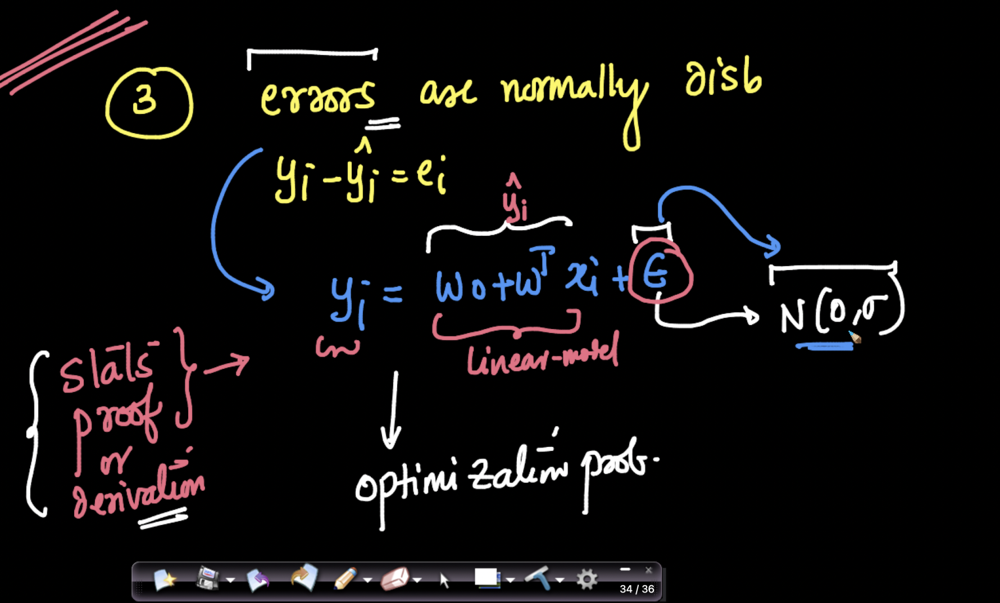

- Third assumption is: Errors (e_i) are normally distributed.
- e_i = yi - y_i_hat
- Fundamental assumption is y_i cannot be perfectly modeled using linear model and there is always going to be an error (epsilon).
- Epsilon (Error) follows normal distribution
- Using this assumption, we arrive at optimization problem in prob and stats. 

**Practical Significance**

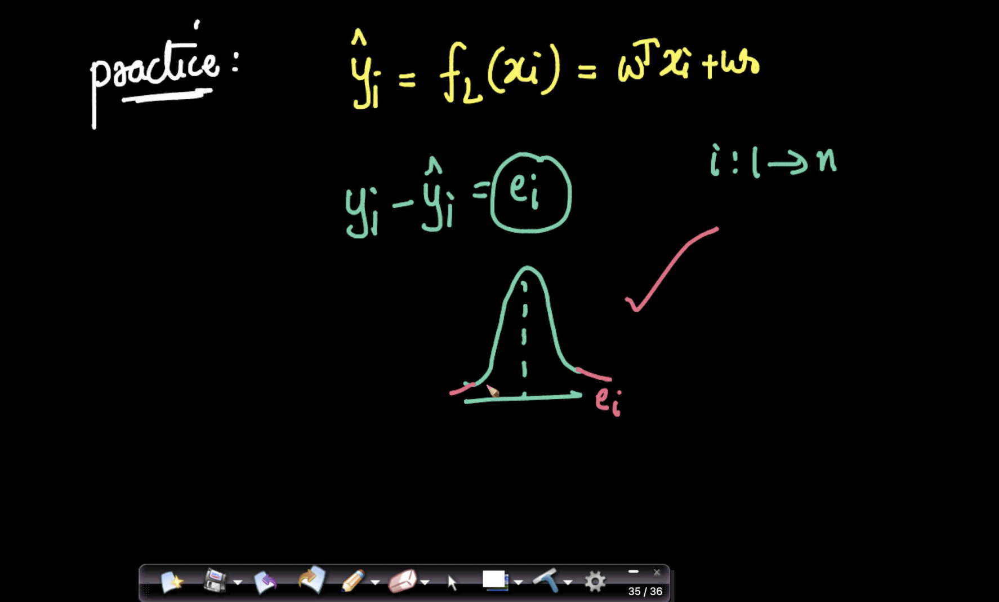

- How is it helpful in practice?
- We build a linear model which gives us `y_i_hat = f(xi) = wT.xi +w0`
-  We have our original yi.
- Errors ei = yi - y_i_hat (i : 1 -> n)
- We plot the distribution the errors. If the distribution of errors is gaussian distribution then the assumption is being sastified (sanity check)

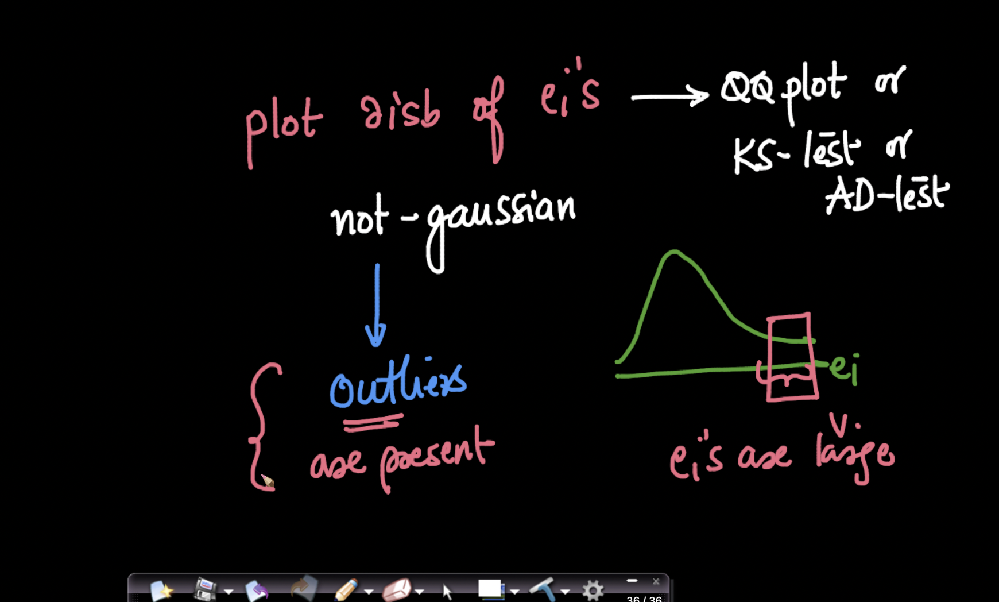

- If you plot the error distribution and it is not normal, then it means there are outliers present in data.
- It means there are some observations where the error is very large. i.e. likelyhood of outliers is more.

# **Impact of outliers on Linear Regression**

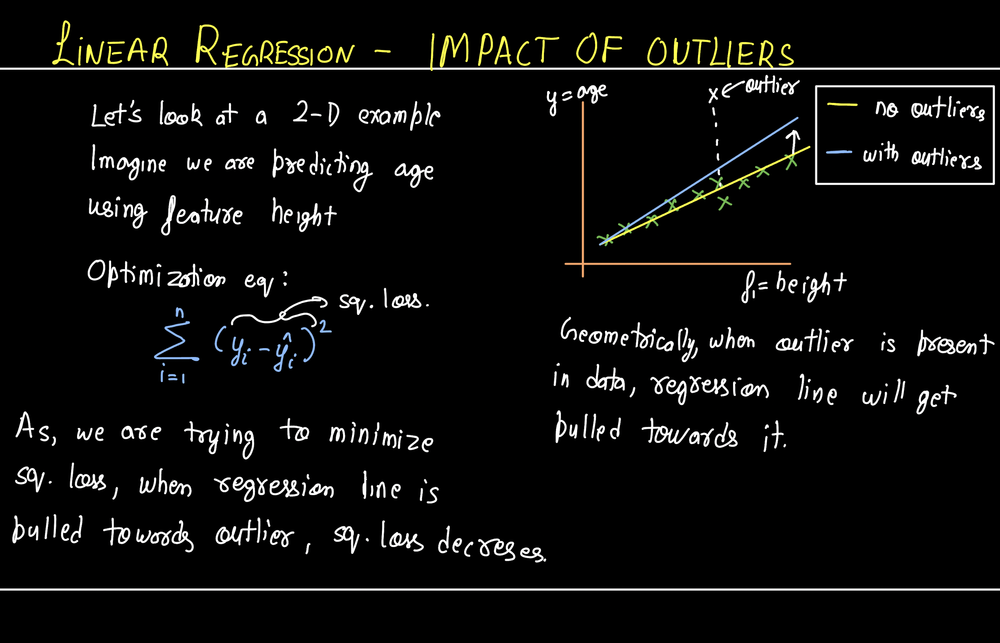

- Let's try to understand impact of outliers using a 2D example.
- Suppose you are trying to predict age using height. 
- When outliers are not present, you get a good line of best fit.
- When there is an outlier present, the line of best fit or regression line will get pulled towards it.
- Why regression line is pulled towards outlier?
- Error is difference between actual and predicted value.
- The closer the regression line is to outlier, less the error. The goal is to get minimum squared error.

#### Question: After plotting the plot for errors, we see the curve is non-gaussian i.e. Outliers are present. How do we identify and remove these outlier?

Ans: 

- Outliers will have large error value (yi - yi_hat). 
- Remove the points will high error as many as you want and fit the model again. 
- Check the distribtion of errors on new model and repeat.

Lets See how is the error distribution for Car24

In [ ]:
Y_hat = hypothesis(X,weight)
errors = Y_hat - Y 

Text(0.5, 1.0, 'Histogram of residuals')

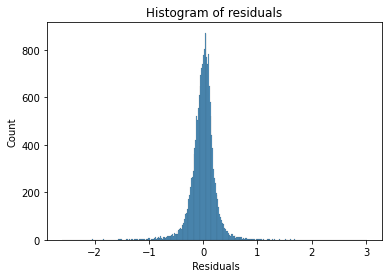

In [ ]:
import seaborn as sns

sns.histplot(errors)
plt.xlabel(" Residuals")
plt.title("Histogram of residuals")


- Recall, We plot the distribution the errors. 
  - If the distribution of errors is gaussian distribution then the assumption of error being normally distributed is being sastified (sanity check) 



# **4.Heteroskedasticity should not exist**

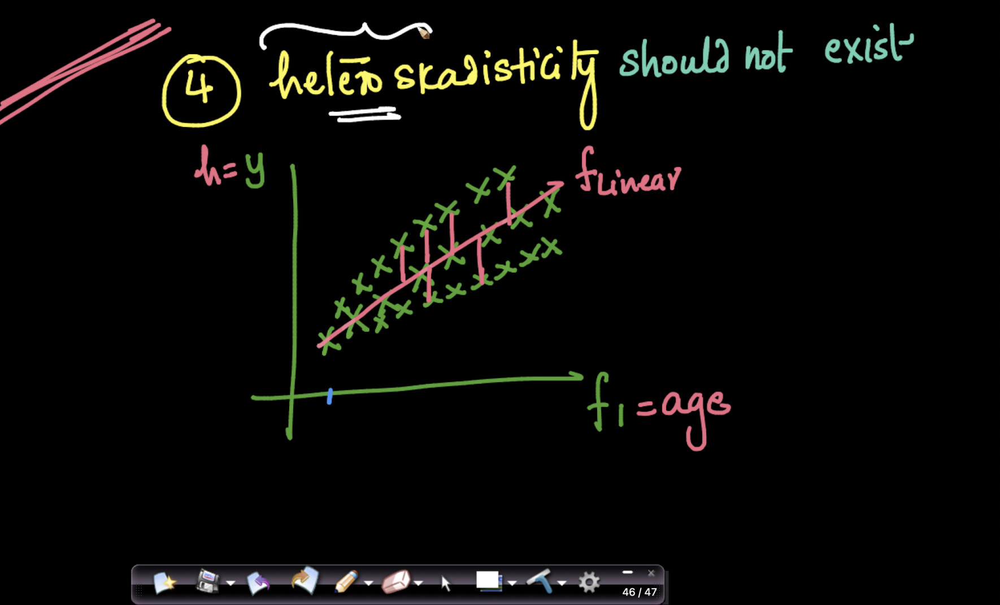

- Continuing with same example of predicting age using height.
- We fit a linear function on data and get f_linear.
- As we go from left to right (or as f1 increase), errors are increasing.

**How to check heteroskedasticity?**

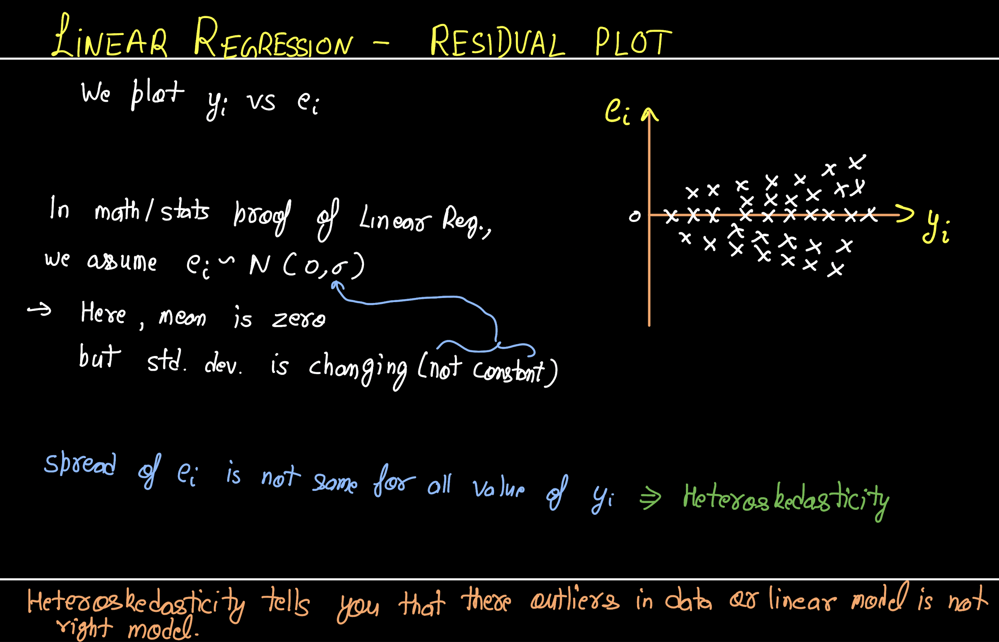

- Residual plots are used to check whether there is heteroskedasticity in the data.
- We take yi on x axis and errors ei on y axis
- There will be good number of points for which errors will be zero. These points will lie on x axis
- There will be points for which error is non zero. These points wil lie either above or below x axis (error can be negative or positive)
- In prob/stats proof of linear regression, we assume the error are normally distributed with mean of 0 and contant standard deviation.
- In the above plot, mean is zero but he variance is changing (not constant) w.r.t yi.
- If the spread is not same for all yi, this implies that there is heteroskedasticity in data.
- The fact that there is extreme variability could me there are outliers in data or linear regression is not the way to approach the problem.

Lets implement heteroskedasticity in Cars24

In [ ]:
Y_hat = hypothesis(X,weight)
errors = Y_hat - Y 

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 1.0, 'Predicted values vs Residuals')

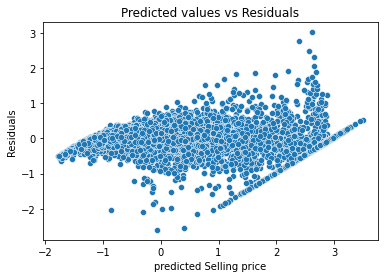

In [ ]:
sns.scatterplot(Y_hat,errors)
plt.xlabel("predicted Selling price")
plt.ylabel("Residuals")
plt.title("Predicted values vs Residuals")

- Notice that As we go from left to right, errors are increasing.

#### What can we understand from this increasing Residuals?
- heteroskedasticity exists in our data
- There is outliers present in the dataset

# **5. No Autocorrelation**

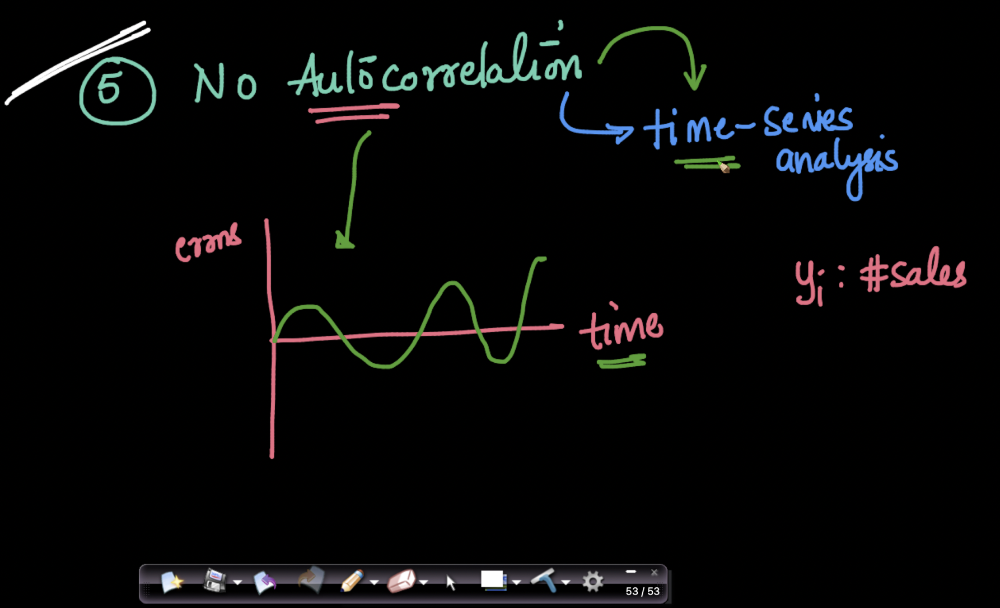

- Autocorrelation only plays role when there is somthing related to time.
- We will cover it in detail in time series analysis.
- For example: sales of amazon w.r.t i.e. Predicting sales on ith day
- When we plot errors w.r.t. time and there is some pattern in the plot, then we say, there is a autocorrelation. (only related to time series data)


#### Summing up

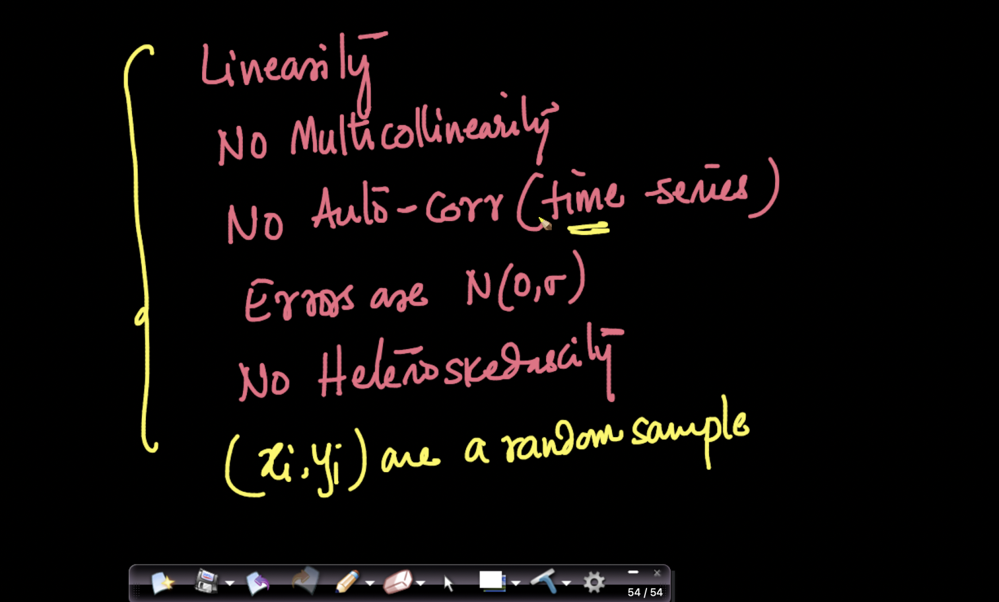

- Summing up the Assumptions:
  - There exist a linear function
  - There is no auto correlation (related to time series)
  - Errors are normally distributed
  - No heteroskedasticity
  - We also have a fundamental assumption: xi,yi are a random sample

## **Question: In Practice, can we build a linear regression if some/all assumptions are not met ?**

Ans: Yes. In practice, we can but be careful and look out for way model can break and fix it. In the end, what matters for us is model working in production / test data.

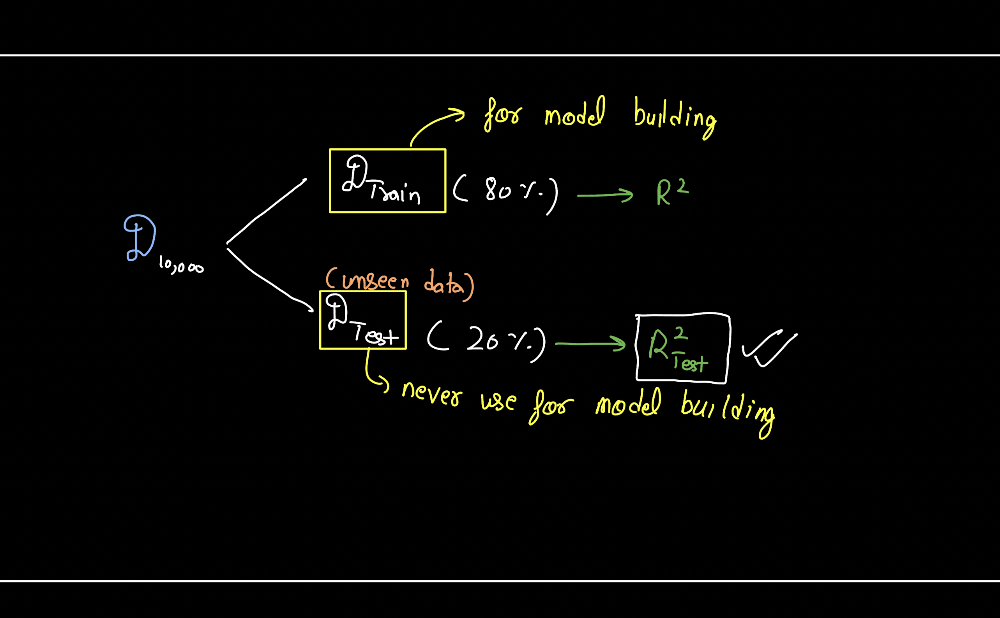

- Whatever data we have, we always break this data into 2 parts. (actually in 3 parts but we will see this later)
- Now, the data is broken in 2 parts i.e. Dtrain and Dtest.
- Rule of thumb is : 80% data goes in training into training, rest 20% goes in Dtest.
- Any model building is done using Dtrain. You should never use Dtest for any model building.
- Let'say you are using R-square metric. You compute R-square on train and test data. But what matters is R-square on test.
- As Dtest is unseen data, the R-square metric on test data is communicated to the outside world.
- R-square test is what matters.
